In [1]:
import pandas as pd
import numpy as np
from pipeline import Outline_boxes

%matplotlib inline
import matplotlib.pyplot as plt


from aug_util import draw_bboxes
from PIL import Image, ImageDraw

/Users/alvanchow/anaconda/lib/python3.6/site-packages/h5py/__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


100%|██████████| 601937/601937 [00:03<00:00, 165574.82it/s]


Num Chips: 35


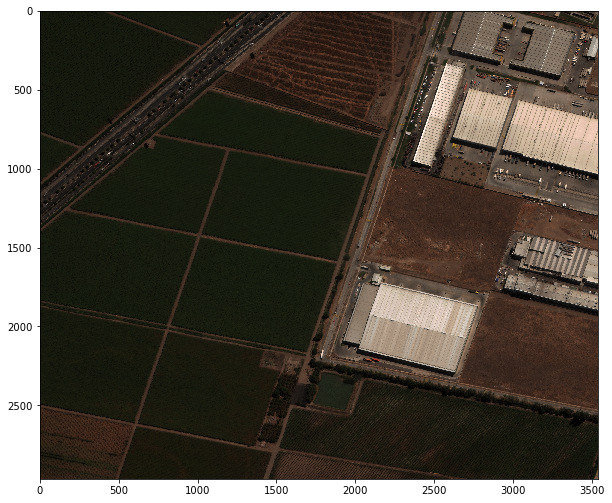

In [2]:
image = Outline_boxes(2393)
image.load_image()

In [20]:

img = image.arr
source1 = Image.fromarray(image.arr)
draw = ImageDraw.Draw(source1)

In [31]:
df = pd.read_csv('../../baseline-1.1/inference/2393_val.csv', header=None)
df.head()

,0,1,2,3,4,5
0,72,127,196,250,44,0.160664
1,11,0,275,119,86,0.152353
2,132,126,258,249,44,0.152153
3,130,157,259,277,44,0.141407
4,101,96,226,220,44,0.140119


In [32]:
df = df[df[5]>=df[5].max()/3]
df.head()

,0,1,2,3,4,5
750,1118,188,1143,209,23,0.506254
751,1190,290,1199,299,18,0.420303
752,1145,200,1159,213,18,0.321065
1000,1340,205,1355,217,18,0.862001
1001,1297,46,1311,59,18,0.848926


In [33]:
df.shape

(193, 6)

In [34]:
df = df.drop([5], axis = 1)
df.head(5)

,0,1,2,3,4
750,1118,188,1143,209,23
751,1190,290,1199,299,18
752,1145,200,1159,213,18
1000,1340,205,1355,217,18
1001,1297,46,1311,59,18


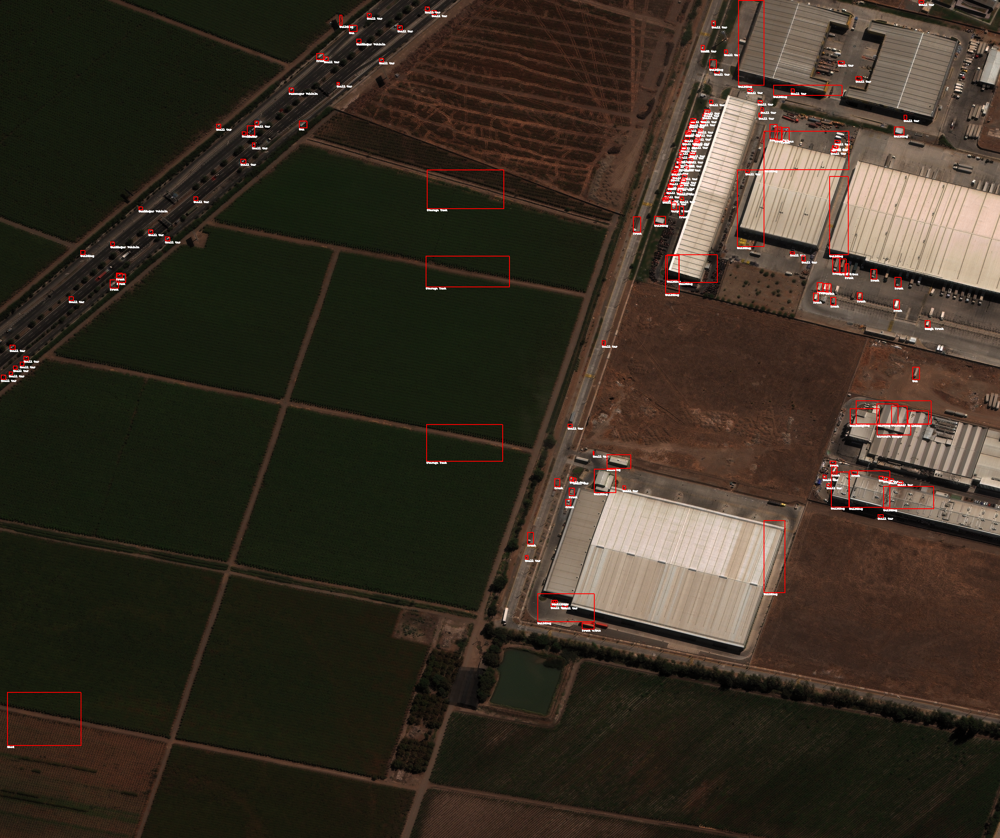

In [35]:
#Change into array
boxes = df.values

#Draw boxes onto image
draw_bboxes(img, boxes, image.labels)